In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os
%matplotlib inline
os.chdir('/Users/apple/Desktop/group/data');
plt.rcParams['figure.figsize'] = (12, 12) # set default size of plots
plt.rcParams.update({'font.size': 18}) # set default font size

Y0=1
RingCull=0
MaxTime=1000

In [2]:
FarmData2001=np.loadtxt('FarmData2001.txt', usecols=range(11))
FarmData2001=np.absolute(FarmData2001);
County=FarmData2001[:,0];
index=[m for m in range(len(County)) if County[m]==1 or County[m]==2 or County[m]==3]
FarmData=FarmData2001[index,:];
N=FarmData.shape[0];

x=FarmData[:,3];
y=FarmData[:,4];
XRange=np.max(x)-np.min(x)+1;
YRange=np.max(y)-np.min(y)+1;
#Size=max(XRange,YRange);
Y0=1;
Status=np.zeros((N,1)); 
Status[0:Y0]=1;
Cows=FarmData[:,6];Sheep=FarmData[:,8];
Suscept=Sheep+10.5*Cows; Transmiss=5.1*10**(-7)*Sheep + 7.7*10**(-7)*Cows;

In [3]:
def WhichGrid(x,y,XRange,YRange,XNum,YNum):
    G=np.floor(x*XNum/XRange)*YNum+np.floor(y*YNum/YRange)+1
    return G

In [4]:
grid=WhichGrid(x-min(x),y-min(y),XRange,YRange,10,10)

In [5]:
index=np.argsort(grid,axis=0) # doubt
index=index.flatten()

In [6]:
x=x[index]
y=y[index]
Status=Status[index]
grid=grid[index]

In [7]:
Xgrid=np.zeros((int(np.max(grid)),1))
Ygrid=np.zeros((int(np.max(grid)),1))
Num=np.zeros((int(np.max(grid)),1))
first_in_grid=np.zeros((int(np.max(grid)),1))
last_in_grid=np.zeros((int(np.max(grid)),1))
Max_Sus_grid=np.zeros((int(np.max(grid)),1))

In [8]:
for i in range(int(np.max(grid))):
    Xgrid[i]=np.floor(i/10.0);
    Ygrid[i]=i%10;
    m=[j for j in range(len(grid)) if grid[j]==(i+1)];
    Num[i]=len(m)
    if Num[i]>0:
        first_in_grid[i]=np.min(m)
        last_in_grid[i]=np.max(m)
        Max_Sus_grid[i]=np.max(Suscept[m])
    else:
        first_in_grid[i]=0
        last_in_grid[i]=-1
        Max_Sus_grid[i]=0

In [9]:
def Kernel(Dist2):
    Dist2=[x*(20**2+20**2)/(XRange**2+YRange**2) for x in Dist2]
    P=[-9.2123*10**(-5),9.5628*10**(-4),3.3966*10**(-3),-3.3687*10**(-2),-1.30519*10**(-1),-0.609262,-3.231772];
    K=np.array(np.exp(np.polyval(P,Dist2)))
    index1=[i for i in range(len(Dist2)) if Dist2[i]<0.0138]
    index2=[i for i in range(len(Dist2)) if Dist2[i]>60*60]
    K[index1]=0.3093
    K[index2]=0
    return K

In [10]:
MaxRate=np.zeros((int(np.max(grid)),int(np.max(grid))))
for i in range(int(np.max(grid))):
    for j in range(int(np.max(grid))):
        if (i==j) or (Num[i]==0) or (Num[j]==0):
            MaxRate[i,j]=float('inf')
        else:
            # not use size
            Dist2=(XRange*np.max([0,abs(Xgrid[i]-Xgrid[j])-1])/10.0)**2+(YRange*np.max([0,abs(Ygrid[i]-Ygrid[j])-1])/10.0)**2
            MaxRate[i,j]=Max_Sus_grid[j]*Kernel([Dist2])

In [11]:
def Iterate(Status,x,y,Suscept,Transmiss,RingCull,grid,first_in_grid,last_in_grid,Num,MaxRate):
    Event=0*Status
    INF=[i for i in range(len(Status)) if (Status[i]>5) and (Status[i]<12)]
    NI=len(INF)
    IGrids=grid[INF]
    for i in range(NI):
        INFi=INF[i]
        MaxProb=1-np.exp(-Transmiss[INFi]*np.multiply(np.transpose(Num),MaxRate[int(IGrids[i]-1),:]))
        Rand1=np.random.uniform(0,1,(1,int(max(grid))))
        m=[i for i in range(len(MaxProb[0])) if (MaxProb[0][i]>Rand1[0][i])]
        for n in range(len(m)):
            s=1
            M=m[n]
            PAB=1-np.exp(-Transmiss[INFi]*MaxRate[int(IGrids[0]-1),M])
            if PAB==1:
                ind=np.arange(first_in_grid[M],last_in_grid[M]+1,1)
                ind=map(int,ind)
                Q=1-np.exp(-Transmiss[INFi]*np.multiply(Suscept[ind],Kernel((x[INFi]-x[ind])**2+(y[INFi]-y[ind])**2)))
                Rand2=np.random.uniform(0,1,Q.shape)
                index=[i for i in range(len(Q)) if (Rand2[i]<Q[i]) and (Status[ind[i]]==0)]
                Event[np.array(ind)[index]]=1
            else:
                for j in range(Num[M]):
                    ind=first_in_grid[M]+j-1
                    ind=map(int,ind)
                    P=1-s*np.power((1-PAB),Num[M]+1-j)
                    R=np.random.uniform(0,1,1)
                    if (P==0):
                        s=0
                        if (Status[ind]==0):
                            Event[ind]=1
                    elif (R<PAB/P):
                        s=0
                        Q=1-np.exp(-Transmiss[INFi]*np.multiply(Suscept[ind],Kernel((x[INFi]-x[ind])**2+(y[INFi]-y[ind])**2)))
                        if (R<Q/P) and (Status[ind]==0):
                            Event[ind]=1
    m=[i for i in range(len(Status)) if Status[i]>0]
    Status[m]=Status[m]+1
    Status=Status+Event
    
    m=[i for i in range(len(Status)) if Status[i]==13]
    for i in range(len(m)):
        Status[m[i]]=-1
        D=np.power(x[m[i]]-x,2)+np.power(y[m[i]]-y,2)
        n=[i for i in range(len(x)) if D[i]<RingCull**2]
        Status[n]=-1
    return Status

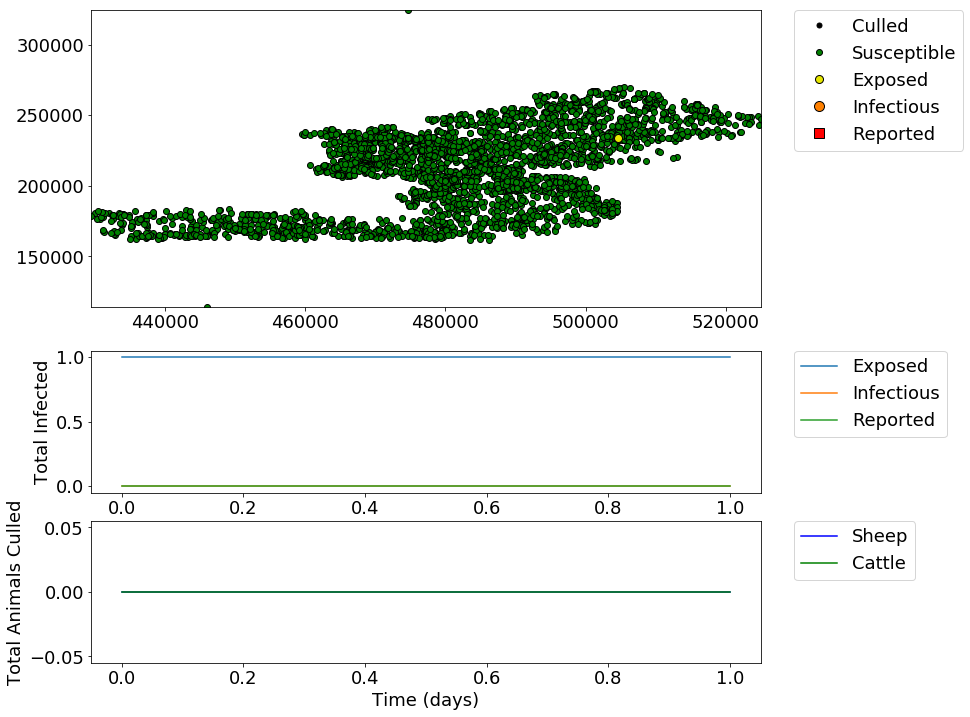

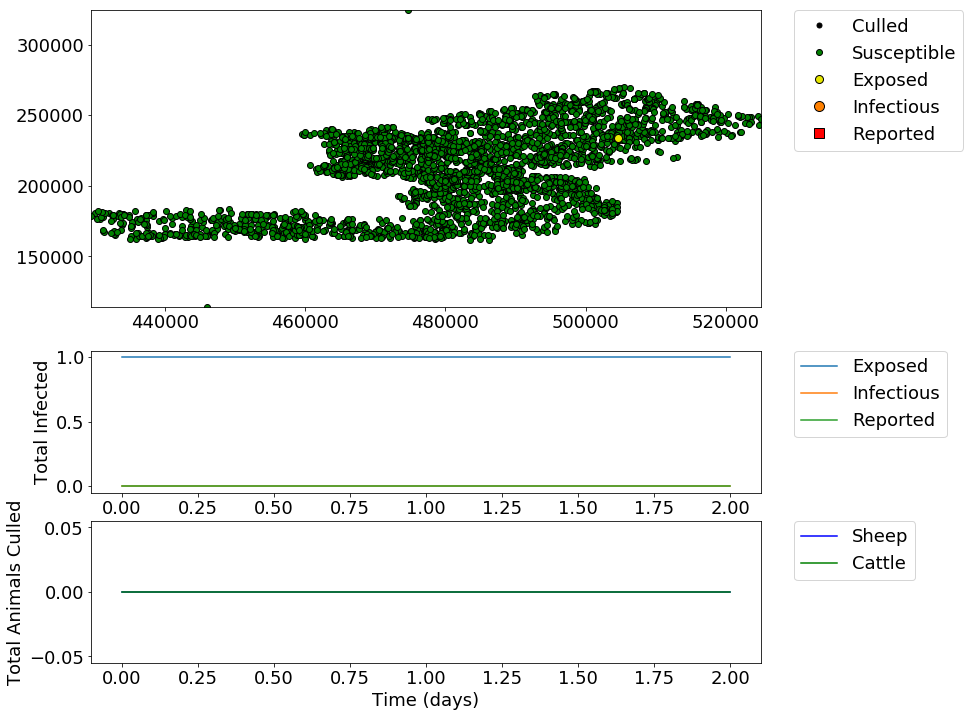

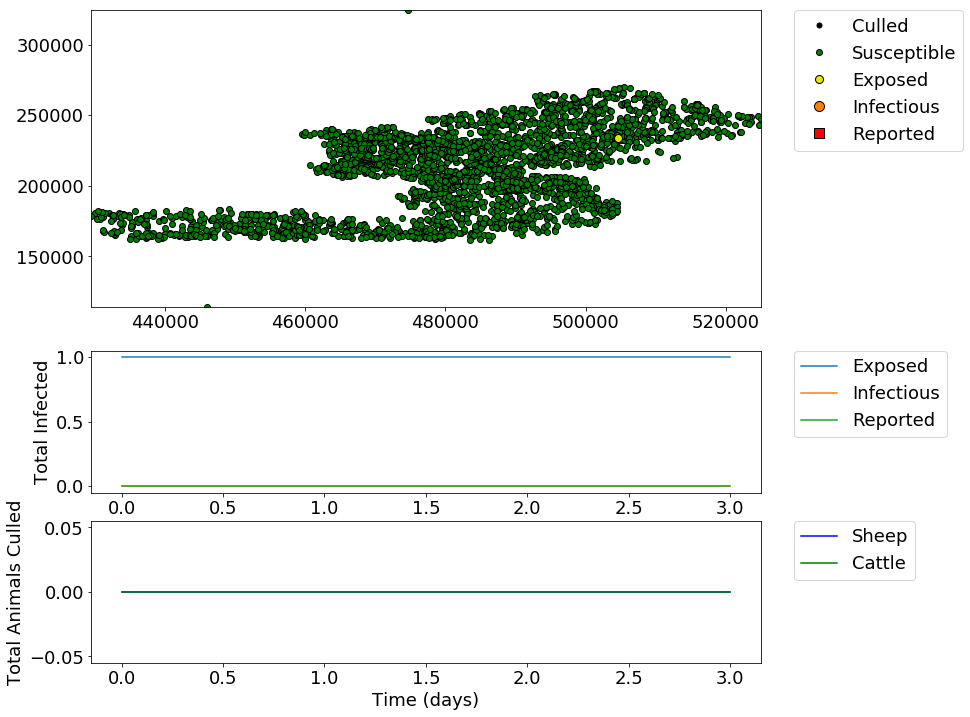

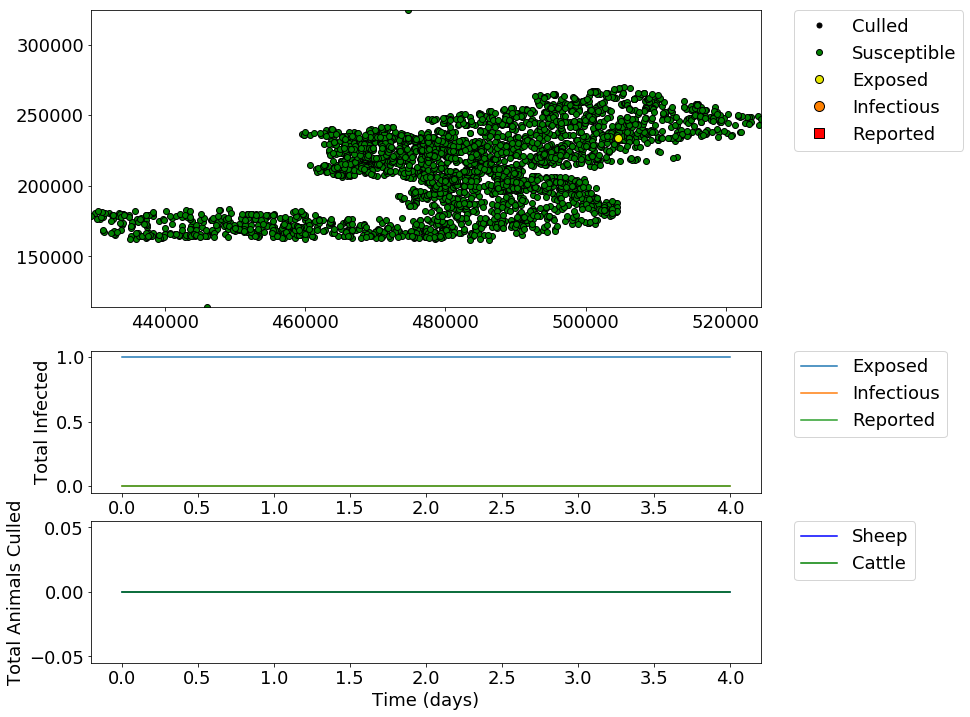

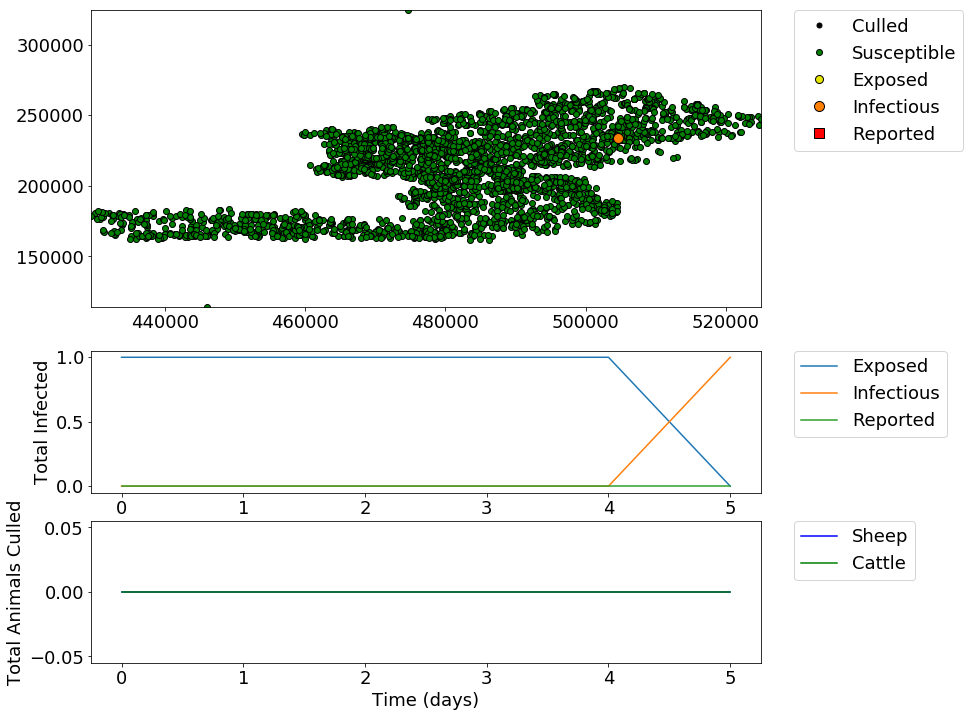

/Users/apple/anaconda2/lib/python2.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in multiply
  


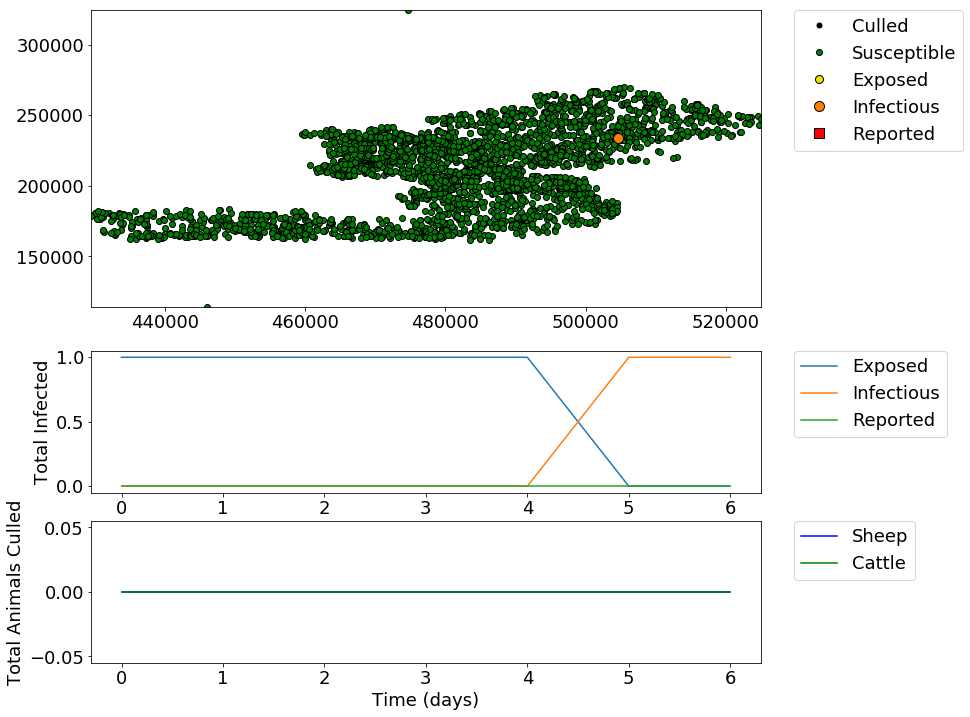

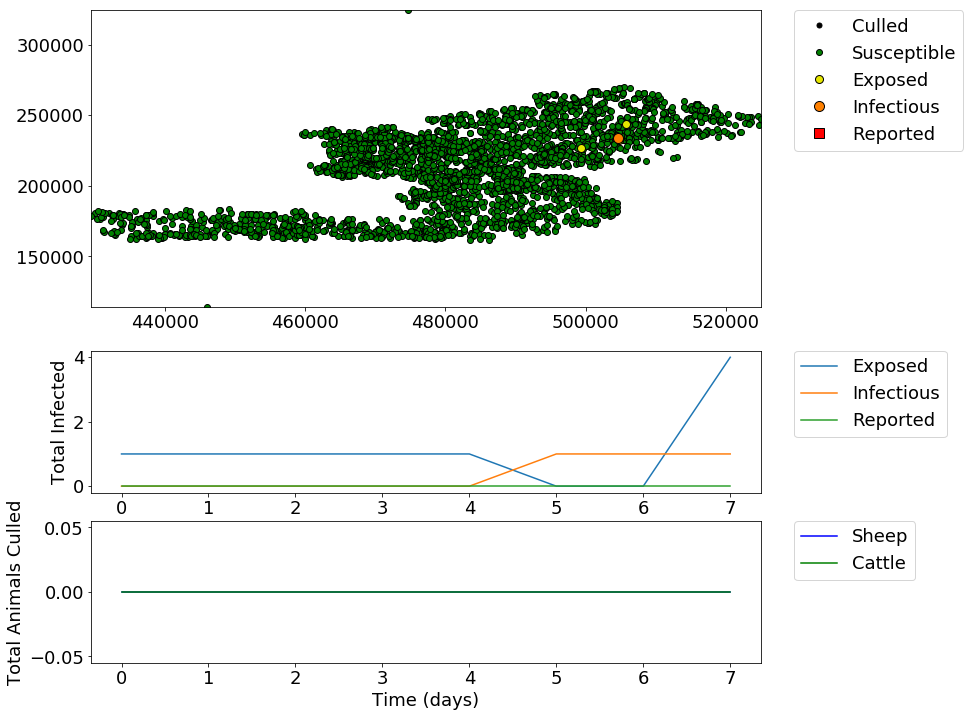

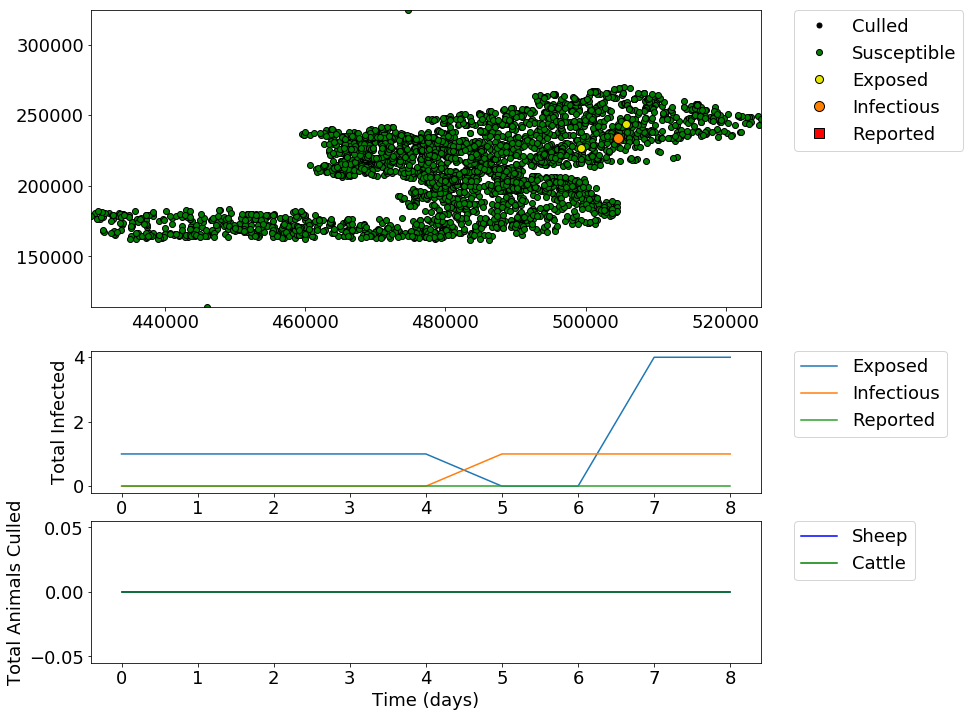

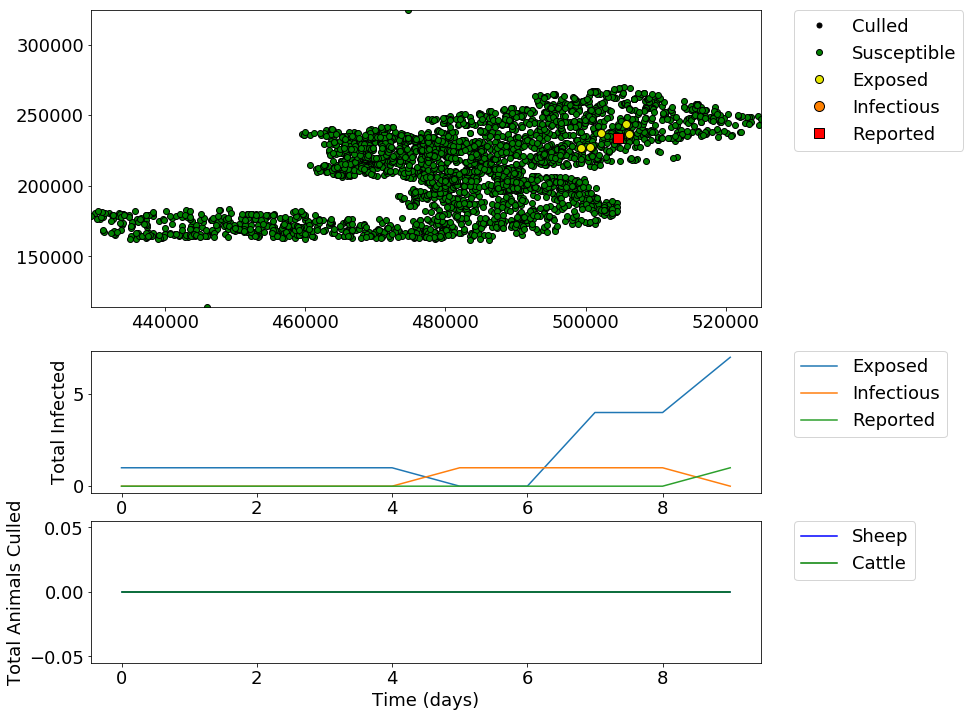

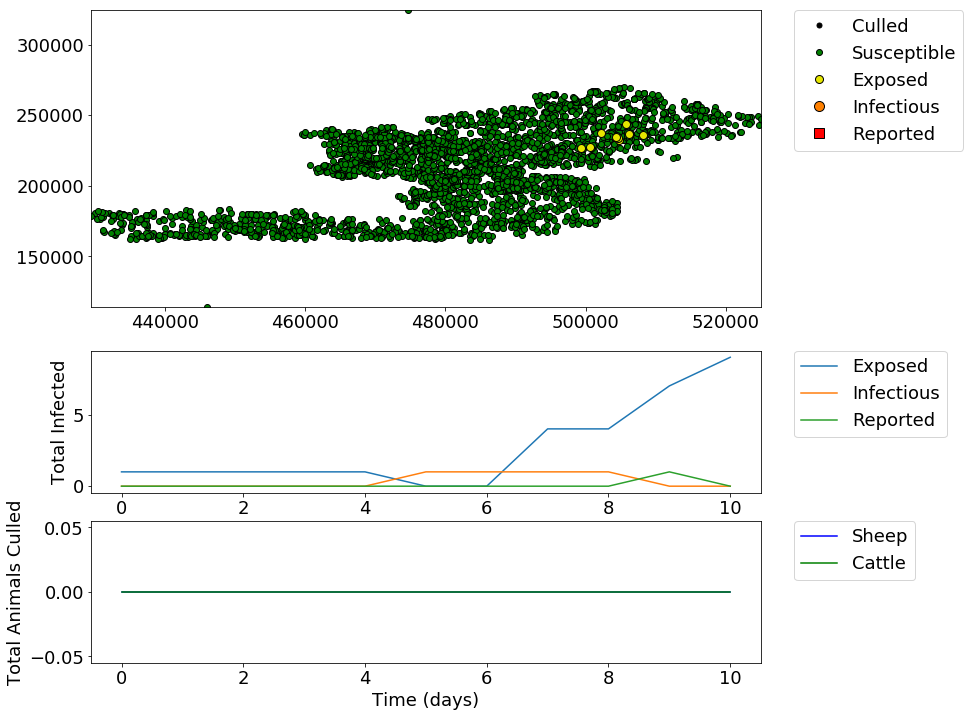

...

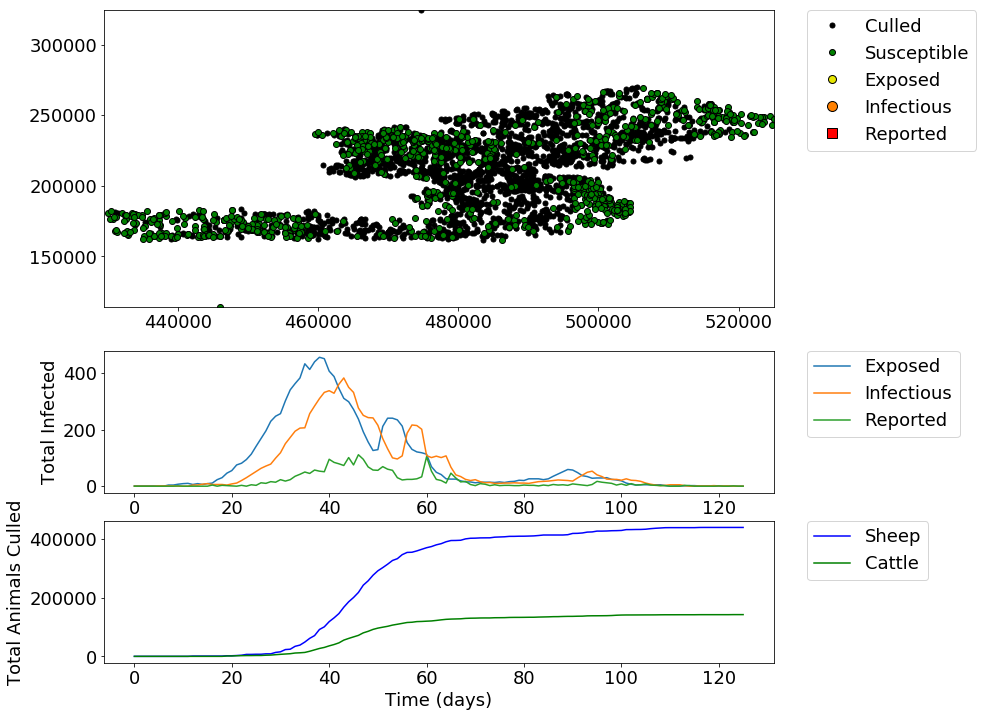

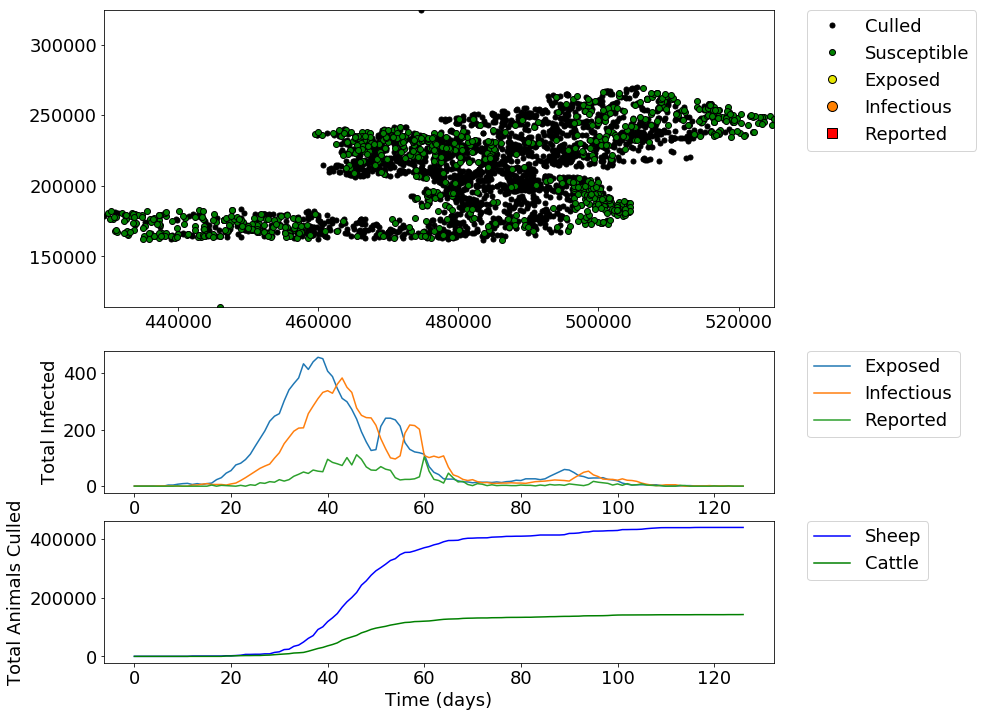

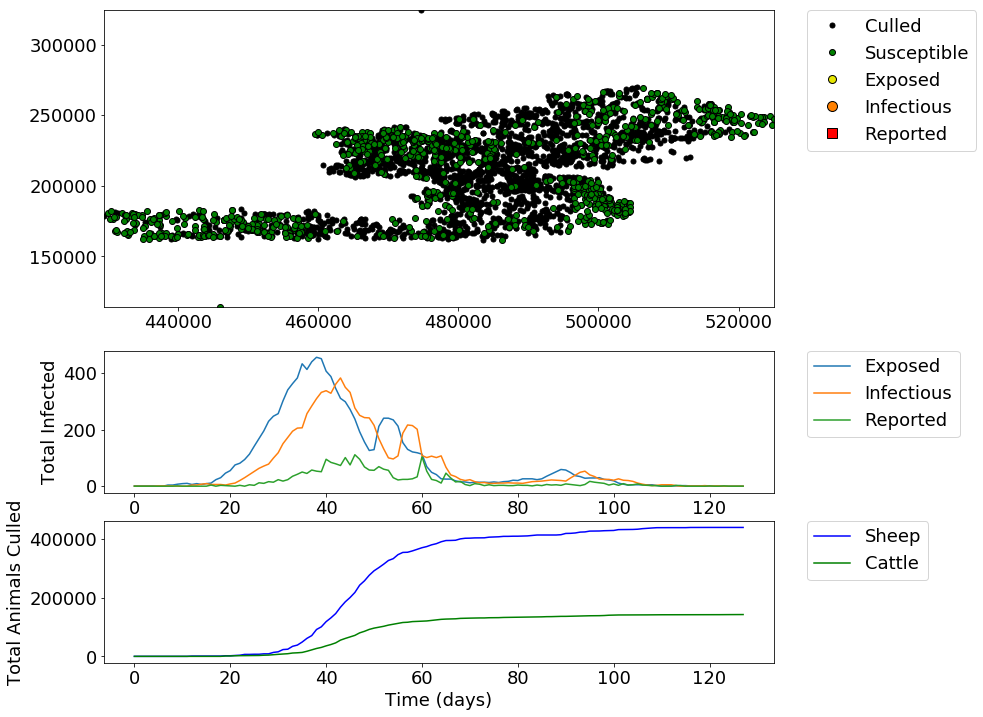

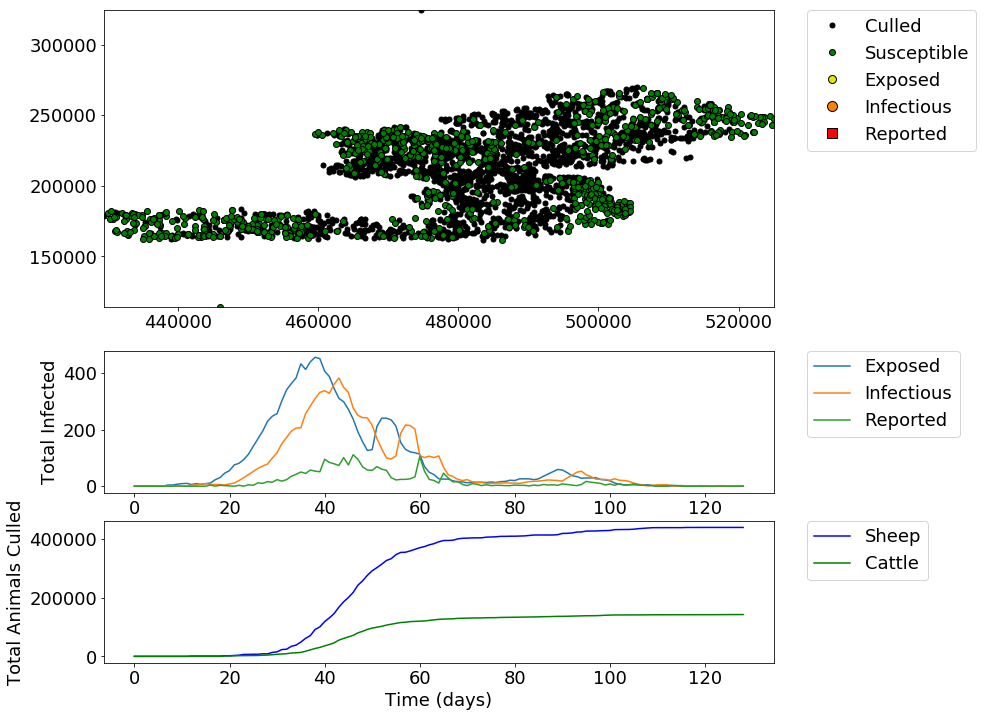

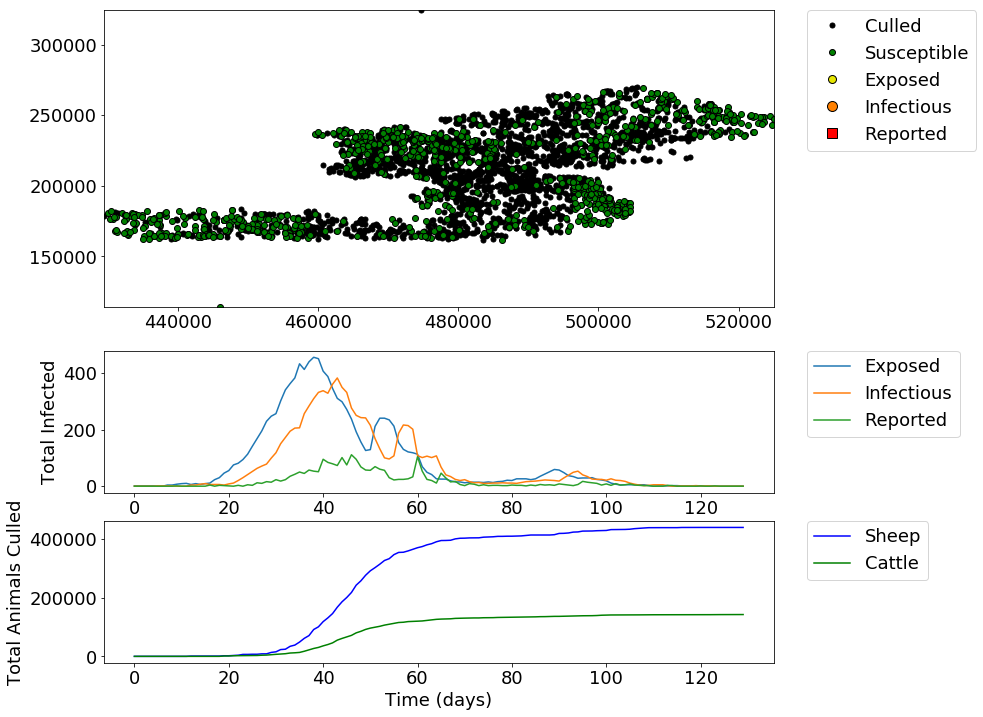

In [12]:
t=[0]; 
S=[len([i for i in range(len(Status)) if Status[i]==0])]
E=[len([i for i in range(len(Status)) if (Status[i]>0) and (Status[i]<=5)])]
I=[len([i for i in range(len(Status)) if (Status[i]>5) and (Status[i]<=9)])]
R=[len([i for i in range(len(Status)) if Status[i]==10])]
R2=[len([i for i in range(len(Status)) if Status[i]>9])]
CullSheep=[0]
CullCattle=[0]
IterateFlag=1
while (t[-1]<MaxTime) and (IterateFlag):
    Status=Iterate(Status,x,y,Suscept,Transmiss,RingCull,grid,first_in_grid,last_in_grid,Num,MaxRate)
    Sus=[i for i in range(len(Status)) if Status[i]==0]
    Exp=[i for i in range(len(Status)) if (Status[i]>0) and (Status[i]<=5)]
    Inf=[i for i in range(len(Status)) if (Status[i]>5) and (Status[i]<=9)]
    Rep=[i for i in range(len(Status)) if Status[i]==10]
    Rep2=[i for i in range(len(Status)) if Status[i]>9]
    Culled=[i for i in range(len(Status)) if Status[i]<0]
    S.append(len(Sus))
    E.append(len(Exp))
    I.append(len(Inf))
    R.append(len(Rep))
    R2.append(len(Rep2))
    CullSheep.append(np.sum(Sheep[Culled]))
    CullCattle.append(np.sum(Cows[Culled]))
    t.append(t[-1]+1)
    if t[-1]>5:
        if E[-4]+I[-4]+R2[-4]==0:
            IterateFlag=0
    plt.subplot(2,1,1);
    plt.xlim(min(x), max(x));
    plt.ylim(min(y), max(y));
    plt.plot(x[Culled],y[Culled],'k.',markersize=10,label='Culled');
    plt.plot(x[Sus],y[Sus],'ko',markerfacecolor ='green',markersize=6,label='Susceptible');
    plt.plot(x[Exp],y[Exp],'ko',markerfacecolor =[0.9,0.9,0], markersize=8,label='Exposed');
    plt.plot(x[Inf],y[Inf],'ko',markerfacecolor =[1, 0.5, 0], markersize=10,label='Infectious');
    plt.plot(x[Rep],y[Rep],'ks',markerfacecolor ='red', markersize=10,label='Reported');
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.subplot(4,1,3);
    plt.plot(t,E,label='Exposed')
    plt.plot(t,I,label='Infectious')
    plt.plot(t,R,label='Reported')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.ylabel('Total Infected')
    plt.subplot(4,1,4);
    plt.plot(t,CullSheep,'-b',label='Sheep')
    plt.plot(t,CullCattle,'-g',label='Cattle');
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.ylabel('Total Animals Culled')
    plt.xlabel('Time (days)')
    plt.show()

In [13]:
grid

array([  3.,   3.,   3., ...,  97.,  97.,  97.])

In [14]:
S

[3109,
 3109,
 3109,
 3109,
 3109,
 3109,
 3109,
 3105,
 3105,
 3102,
 3100,
 3099,
 3099,
 3096,
 3096,
 3091,
 3088,
 3076,
 3066,
 3050,
 3036,
 3013,
 2995,
 2972,
 2937,
 2895,
 2845,
 2800,
 2743,
 2690,
 2639,
 2544,
 2460,
 2381,
 2308,
 2207,
 2132,
 2021,
 1926,
 1858,
 1801,
 1745,
 1676,
 1616,
 1560,
 1530,
 1508,
 1484,
 1460,
 1434,
 1401,
 1297,
 1244,
 1220,
 1200,
 1189,
 1143,
 1114,
 1099,
 1082,
 1076,
 1074,
 1065,
 1058,
 1056,
 1051,
 1049,
 1046,
 1043,
 1041,
 1039,
 1035,
 1032,
 1029,
 1028,
 1024,
 1022,
 1016,
 1012,
 1007,
 1004,
 996,
 990,
 986,
 984,
 978,
 961,
 947,
 935,
 925,
 921,
 913,
 910,
 901,
 897,
 892,
 884,
 880,
 877,
 875,
 873,
 873,
 873,
 873,
 870,
 868,
 868,
 868,
 868,
 868,
 868,
 867,
 867,
 867,
 866,
 866,
 866,
 866,
 866,
 866,
 866,
 866,
 866,
 866,
 866,
 866,
 866,
 866,
 866,
 866]

In [15]:
I

[0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 4,
 4,
 7,
 9,
 6,
 6,
 6,
 4,
 8,
 11,
 20,
 30,
 41,
 52,
 63,
 71,
 78,
 99,
 118,
 150,
 172,
 194,
 205,
 206,
 256,
 283,
 309,
 331,
 337,
 328,
 360,
 382,
 349,
 331,
 276,
 250,
 242,
 241,
 215,
 168,
 132,
 100,
 96,
 107,
 187,
 216,
 214,
 201,
 108,
 101,
 106,
 101,
 107,
 67,
 40,
 34,
 24,
 20,
 23,
 16,
 12,
 13,
 10,
 10,
 11,
 11,
 12,
 11,
 11,
 10,
 13,
 16,
 17,
 18,
 20,
 22,
 21,
 20,
 18,
 29,
 39,
 49,
 53,
 40,
 34,
 25,
 24,
 24,
 21,
 26,
 21,
 20,
 17,
 11,
 7,
 4,
 2,
 3,
 5,
 5,
 5,
 2,
 0,
 0,
 1,
 1,
 1,
 2,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0]

In [16]:
E

[1,
 1,
 1,
 1,
 1,
 0,
 0,
 4,
 4,
 7,
 9,
 10,
 6,
 9,
 6,
 9,
 11,
 23,
 30,
 46,
 55,
 75,
 81,
 94,
 113,
 141,
 168,
 195,
 229,
 247,
 256,
 301,
 340,
 362,
 382,
 432,
 412,
 439,
 455,
 450,
 406,
 387,
 345,
 310,
 298,
 271,
 237,
 192,
 156,
 126,
 129,
 211,
 240,
 240,
 234,
 212,
 154,
 130,
 121,
 118,
 113,
 69,
 49,
 41,
 26,
 25,
 25,
 19,
 15,
 15,
 12,
 14,
 14,
 14,
 13,
 15,
 13,
 16,
 17,
 21,
 20,
 26,
 26,
 26,
 23,
 26,
 35,
 43,
 51,
 59,
 57,
 48,
 37,
 34,
 28,
 29,
 29,
 30,
 24,
 22,
 19,
 11,
 7,
 4,
 5,
 5,
 5,
 5,
 5,
 2,
 0,
 1,
 1,
 1,
 2,
 2,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0]

In [17]:
R

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 4,
 0,
 3,
 2,
 1,
 0,
 3,
 0,
 5,
 3,
 12,
 10,
 16,
 14,
 23,
 18,
 23,
 35,
 42,
 50,
 45,
 57,
 53,
 51,
 95,
 84,
 79,
 73,
 101,
 75,
 111,
 95,
 68,
 57,
 56,
 69,
 60,
 56,
 30,
 22,
 24,
 24,
 26,
 33,
 104,
 53,
 24,
 20,
 11,
 46,
 29,
 15,
 17,
 6,
 2,
 9,
 7,
 2,
 5,
 2,
 3,
 3,
 2,
 2,
 4,
 3,
 3,
 1,
 4,
 2,
 6,
 4,
 5,
 3,
 8,
 6,
 4,
 2,
 6,
 17,
 14,
 12,
 10,
 4,
 8,
 3,
 9,
 4,
 5,
 8,
 4,
 3,
 2,
 2,
 0,
 0,
 0,
 3,
 2,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0]

In [18]:
R2

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 4,
 4,
 7,
 5,
 6,
 3,
 4,
 3,
 8,
 8,
 20,
 25,
 38,
 40,
 53,
 55,
 64,
 76,
 100,
 127,
 137,
 152,
 155,
 161,
 199,
 230,
 258,
 236,
 253,
 249,
 287,
 281,
 274,
 220,
 181,
 182,
 185,
 185,
 146,
 108,
 76,
 70,
 74,
 83,
 163,
 190,
 181,
 97,
 55,
 77,
 86,
 90,
 61,
 38,
 25,
 17,
 18,
 18,
 14,
 9,
 10,
 8,
 8,
 7,
 8,
 9,
 10,
 7,
 8,
 7,
 12,
 12,
 15,
 12,
 16,
 17,
 18,
 12,
 12,
 25,
 37,
 43,
 36,
 26,
 22,
 15,
 20,
 16,
 18,
 17,
 17,
 15,
 9,
 7,
 4,
 2,
 0,
 3,
 5,
 5,
 2,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 0]

In [19]:
CullSheep

[0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 948.0,
 948.0,
 948.0,
 948.0,
 948.0,
 948.0,
 948.0,
 2076.0,
 2076.0,
 2795.0,
 3856.0,
 6660.0,
 6660.0,
 7173.0,
 7173.0,
 8584.0,
 8585.0,
 13412.0,
 15486.0,
 23115.0,
 24314.0,
 34167.0,
 38377.0,
 48681.0,
 61333.0,
 70712.0,
 91493.0,
 100575.0,
 118214.0,
 131080.0,
 145789.0,
 167458.0,
 185813.0,
 200445.0,
 217609.0,
 242481.0,
 257267.0,
 276287.0,
 291436.0,
 302290.0,
 313896.0,
 326600.0,
 332735.0,
 346480.0,
 354031.0,
 354645.0,
 359201.0,
 364664.0,
 370068.0,
 374010.0,
 379890.0,
 383863.0,
 390355.0,
 394552.0,
 394822.0,
 395485.0,
 400177.0,
 402290.0,
 402644.0,
 403498.0,
 403674.0,
 403813.0,
 406000.0,
 406654.0,
 407315.0,
 408757.0,
 408819.0,
 409278.0,
 409323.0,
 409783.0,
 410335.0,
 411690.0,
 413349.0,
 413360.0,
 413360.0,
 413388.0,
 413388.0,
 414440.0,
 418721.0,
 419091.0,
 420351.0,
 423254.0,
 423900.0,
 426684.0,
 426687.0,
 427066.0,
 427977.0,
 428255.0,
 428872.0,
 4

In [20]:
CullCattle

[0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 1223.0,
 1223.0,
 2095.0,
 2323.0,
 2711.0,
 2711.0,
 3005.0,
 3005.0,
 3859.0,
 4313.0,
 5679.0,
 6877.0,
 7972.0,
 9029.0,
 11340.0,
 12139.0,
 13363.0,
 17355.0,
 22116.0,
 26884.0,
 30420.0,
 35718.0,
 40270.0,
 45937.0,
 55299.0,
 61057.0,
 66291.0,
 71435.0,
 80025.0,
 85310.0,
 91793.0,
 96197.0,
 99345.0,
 102355.0,
 106445.0,
 109340.0,
 112328.0,
 115339.0,
 116205.0,
 118397.0,
 118921.0,
 119810.0,
 120592.0,
 122358.0,
 124356.0,
 126083.0,
 126974.0,
 127454.0,
 127931.0,
 129350.0,
 129951.0,
 130206.0,
 130712.0,
 130852.0,
 130853.0,
 131549.0,
 131690.0,
 131851.0,
 132531.0,
 132740.0,
 132801.0,
 132934.0,
 133204.0,
 133214.0,
 133820.0,
 134186.0,
 134575.0,
 135184.0,
 135317.0,
 135862.0,
 136231.0,
 136271.0,
 136736.0,
 136955.0,
 137939.0,
 138186.0,
 138254.0,
 138387.0,
 138559.0,
 139099.0,
 140106.0,
 140721.0,
 140975.0,
 140997.0,
 141055.0,


In [21]:
t

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129]